In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np
import matplotlib.pyplot as plt

from utils.file import VideoFile
from utils.load import load_videos

%load_ext autoreload
%autoreload 2

import multiprocessing
multiprocessing.set_start_method('spawn', force=True) # OpenCV in dataloader

import matplotlib.pyplot as plt
import gc

ToImage = T.ToPILImage()

https://stats.stackexchange.com/questions/219914/rnns-when-to-apply-bptt-and-or-update-weights/220111

https://pdfs.semanticscholar.org/9a98/4104e5d3ab9c9f5d27e50d99e5ea1fb25429.pdf - Convolutional LSTMs

https://github.com/pytorch/examples/tree/master/word_language_model - Pytorch LSTM example

https://arxiv.org/abs/1801.10308 - Nested LSTMs

http://cs231n.stanford.edu/reports/2017/pdfs/423.pdf - Previous 231

https://arxiv.org/pdf/1601.06759.pdf - PixelRNN

https://arxiv.org/pdf/1608.05148.pdf - Google Image Compression

https://arxiv.org/abs/1511.06085 - Baseline for previous paper

https://arxiv.org/abs/1512.03385 - Deep Residual Learning (ResNet)

https://arxiv.org/pdf/1708.00838v1.pdf - Image Compression layer on top of existing codecs

https://www.cv-foundation.org/openaccess/content_iccv_2015/papers/Tran_Learning_Spatiotemporal_Features_ICCV_2015_paper.pdf - 3D convolutions, suggests that transfer learning from single image stuff not so useful

https://arxiv.org/pdf/1805.12295.pdf - Newer google image compression, good references

https://arxiv.org/pdf/1804.09869.pdf - Video compression

http://openaccess.thecvf.com/content_cvpr_2017/papers/Chollet_Xception_Deep_Learning_CVPR_2017_paper.pdf - Depthwise convolution

https://arxiv.org/abs/1802.09371

https://github.com/Rolinh/VQMT - MSSSIM testing

https://arxiv.org/pdf/1804.06919v1.pdf - Another video compression thing, uses offline motion estimation again

Break training data into 30 frame chunks: chunks may be unnecessary variable lengths supported

30 Frame chunks: batch size 8ish (assuming 16 bit floats)

Nested LSTM?

LSTMCell

PixelCNN style context

In [2]:
data_loader = load_videos("seqs/objective-2-slow/list.txt")
dtype = torch.cuda.FloatTensor 
#dtype = torch.FloatTensor 

# Simple explicit state strategy

Train on reference images (not reconstructions), to allow parallelizing training.

In [3]:
prev_frames = 2
num_conv = 4

In [4]:
class Squeeze(nn.Module):
    def forward(self, x):
        return x.squeeze(dim=2)
    
class Debug(nn.Module):
    def forward(self, x):
        print("Debug ")
        print(x.shape)
        return x

In [5]:
layers = []
prev_channels = 3
for i in range(num_conv):
    layers.append(nn.Conv3d(prev_channels, 32, (3, 3, 3), stride=1, padding=(1, 1, 1)))
    layers.append(nn.ReLU())
    prev_channels = 32
    
layers.append(nn.Conv3d(prev_channels, 16, (3, 1, 1), stride=1, padding=(0, 0, 0))) # Reduce time dimension to one
layers.append(Squeeze())
layers.append(nn.ReLU())
layers.append(nn.Conv2d(16, 3, 3, stride=1, padding=(1, 1)))
layers.append(nn.ReLU())
layers.append(nn.Conv2d(3, 3, (2, 2), stride=(2, 2), padding=0))
    

model = nn.Sequential(*layers).type(dtype)

In [6]:
calc_loss = nn.MSELoss()

def evaluate(model, solver, data, truth):
    data = data.type(dtype)
    truth = truth.type(dtype)
    
    result = model(data)
    loss = calc_loss(result, truth)
    
    solver.zero_grad()
    loss.backward()
    solver.step()
    
    return loss

In [7]:
def train_on_video(solver, model, video):
    num_frames = video.shape[0]
    video = F.pad(video, (0, 0, 0, 0, 0, 0, prev_frames, 0))
    
    # Display first frame of video
    img = video[2].cpu()
    plt.imshow(ToImage(img))
    plt.show()
    
    for i in range(prev_frames, prev_frames+num_frames):
        subset = video[i - prev_frames:i + 1].transpose(0, 1)
        num_chunks_tall = subset.shape[2] // 32
        num_chunks_wide = subset.shape[3] // 32
        split = subset.view(subset.shape[0], subset.shape[1], num_chunks_tall, 32, num_chunks_wide, 32)
        #split = split.permute(0, 1, 2, 4, 3, 5)
            
        if num_chunks_tall % 2 != 0:
            even = split.narrow(2, 0, num_chunks_tall - 1)
            odd = split.narrow(2, 1, num_chunks_tall - 1)
            num_odd_chunks_tall = num_chunks_tall // 2
        else:
            even = split
            odd = split.narrow(2, 1, num_chunks_tall - 2)
            num_odd_chunks_tall = num_chunks_tall // 2 - 1

        if num_chunks_wide % 2 != 0:
            even = even.narrow(4, 0, num_chunks_wide - 1)
            odd = odd.narrow(4, 1, num_chunks_wide - 1)
            num_odd_chunks_wide = num_chunks_wide // 2
        else:
            odd = odd.narrow(4, 0, num_chunks_wide - 2)
            num_odd_chunks_wide = num_chunks_wide // 2 - 1

        even = even.view(subset.shape[0], subset.shape[1], num_chunks_tall // 2, 64, num_chunks_wide // 2, 64)
        odd = odd.view(subset.shape[0], subset.shape[1], num_odd_chunks_tall, 64, num_odd_chunks_wide, 64)
            
        even = even.permute(2, 4, 0, 1, 3, 5).clone().view(-1, 3, prev_frames + 1, 64, 64)
        even_truths = even[:, :, 2, 32:64, 32:64].clone()
        even[:, :, 2, 32:64, 32:64] = torch.zeros(32, 32)

        for data, truth in zip(even.split(64, 0), even_truths.split(64, 0)):
            loss = evaluate(model, solver, data, truth)
                
        #odd = odd.permute(2, 4, 0, 1, 3, 5).clone().view(-1, 3, prev_frames + 1, 64, 64)
        #for idx, data in enumerate(odd.split(64, 0)):
        #    loss = evaluate(model, solver, data, truth)
                
    print("Loss {}".format(loss))


In [8]:
def train(model, video_set, lr, num_epochs):
    for epoch in range(num_epochs):
        solver = optim.Adam(model.parameters(), lr=lr, betas=(0.5, 0.999), weight_decay=1e-5)
        lr /= 2
        for videos in video_set:
            gc.collect()
            for i in range(len(videos)):
                video = videos[i]
                train_on_video(solver, model, video)
        

In [9]:
#train(model, data_loader, 5e-4, 10)

In [10]:
#torch.save(model.state_dict(), "model")

In [11]:
model.load_state_dict(torch.load("model"))
model = model.eval()

In [12]:
def test(model, video):
    print(video.shape)
    residuals = []
    num_frames = video.shape[0]
    height = video.shape[2]
    width = video.shape[3]
    num_chunks_tall = height // 32
    num_chunks_wide = width // 32
    ctx = torch.zeros(1, 3, prev_frames + 1, height, width).type(dtype)
    for f in range(num_frames):
        print("Frame {}".format(f))
        pred_frame = torch.zeros(3, height, width).type(dtype)
        res_frame = torch.zeros(3, height, width).type(dtype)
        for i in range(num_chunks_tall - 1):
            for j in range(num_chunks_wide - 1):
                sub_ctx = ctx[:, :, :, i*32:i*32+64, j*32:j*32+64]
                pred = model(sub_ctx)
                truth = video[f, :, i*32+32:i*32+64, j*32+32:j*32+64].type(dtype)
                
                res = truth - pred[0]
                pred_frame[:, i*32+32:i*32+64, j*32+32:j*32+64] = pred[0]
                res_frame[:, i*32+32:i*32+64, j*32+32:j*32+64] = res
                sub_ctx[0, :, 2, 32:64, 32:64] = truth
                
        plt.imshow(ToImage(video[f]))
        plt.show()
        plt.imshow(ToImage(pred_frame.cpu()))
        plt.show()
        res_frame = -1.0*torch.max(torch.abs(res_frame), 0, keepdim=True)[0]
        print(res_frame.shape)
        plt.imshow(ToImage(res_frame.cpu()))
        plt.set_cmap('Greys')
        plt.show()
        #plt.imshow(ToImage(ctx[0, :, 2, :, :].cpu()))
        #plt.show()
                
        ctx[:, :, 0, :, :] = ctx[:, :, 1, :, :]
        ctx[:, :, 1, :, :] = ctx[:, :, 2, :, :]
        ctx[:, :, 2, :, :] = 0

torch.Size([100, 3, 864, 1952])
Frame 0


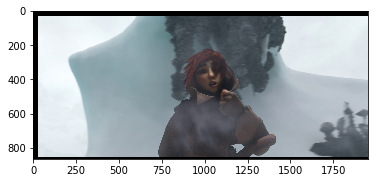

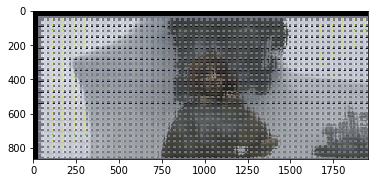

torch.Size([1, 864, 1952])


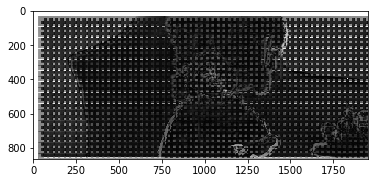

Frame 1


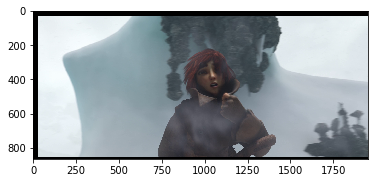

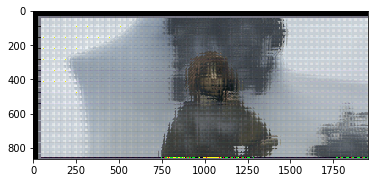

torch.Size([1, 864, 1952])


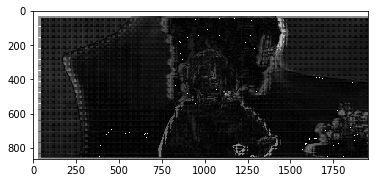

Frame 2


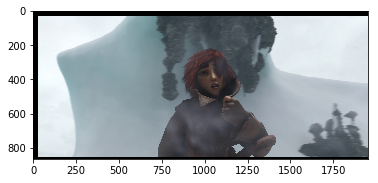

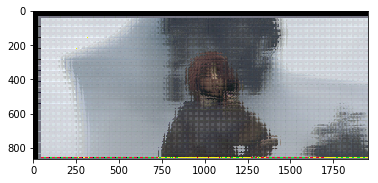

torch.Size([1, 864, 1952])


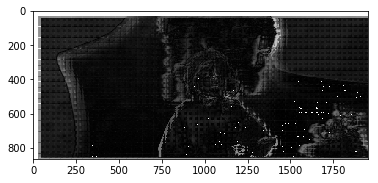

Frame 3


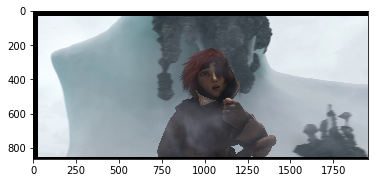

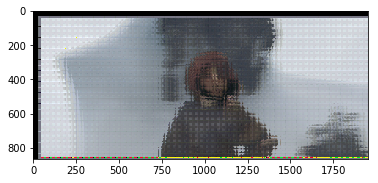

torch.Size([1, 864, 1952])


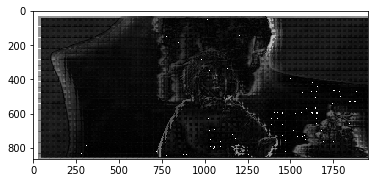

Frame 4


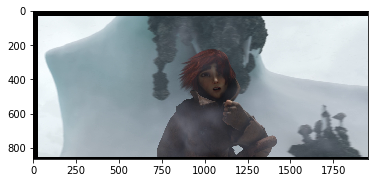

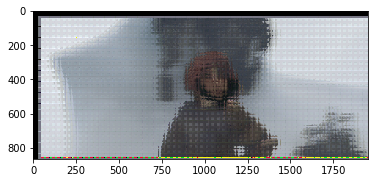

torch.Size([1, 864, 1952])


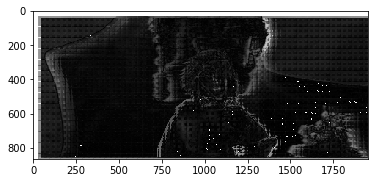

Frame 5


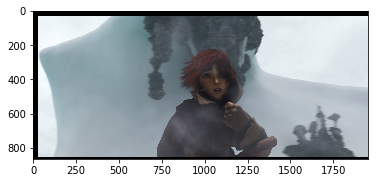

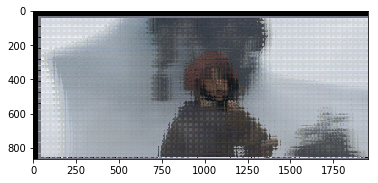

torch.Size([1, 864, 1952])


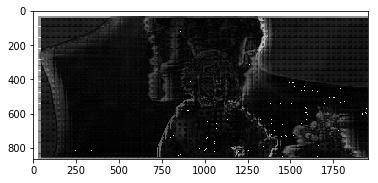

Frame 6


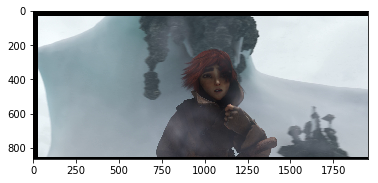

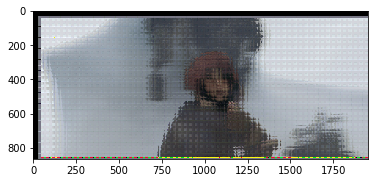

torch.Size([1, 864, 1952])


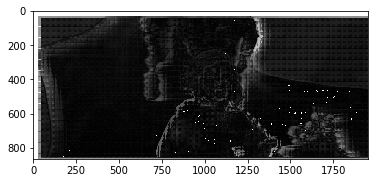

Frame 7


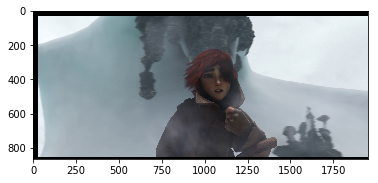

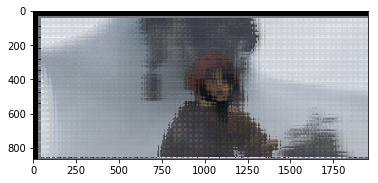

torch.Size([1, 864, 1952])


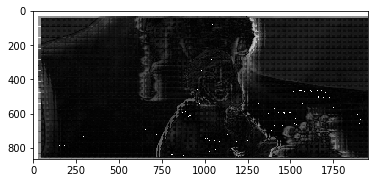

Frame 8


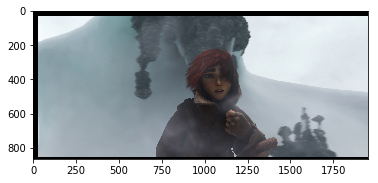

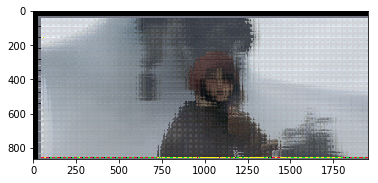

torch.Size([1, 864, 1952])


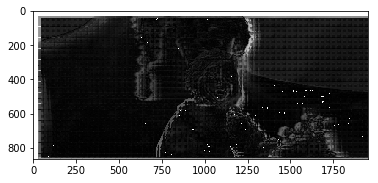

Frame 9


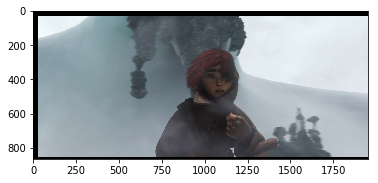

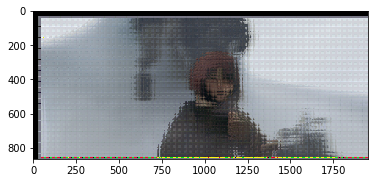

torch.Size([1, 864, 1952])


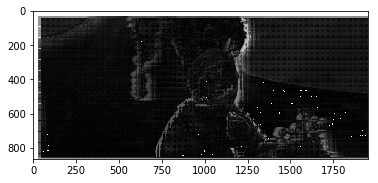

Frame 10


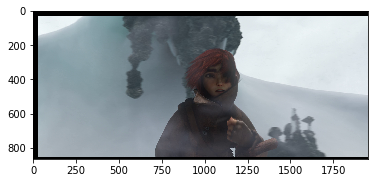

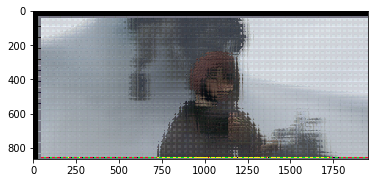

torch.Size([1, 864, 1952])


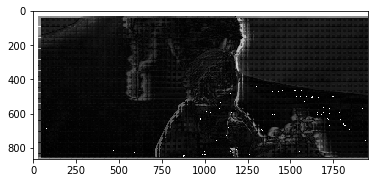

Frame 11


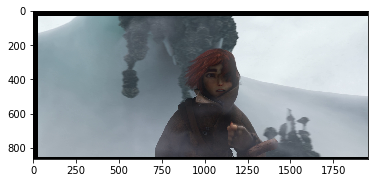

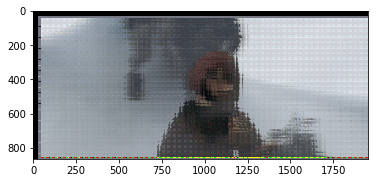

torch.Size([1, 864, 1952])


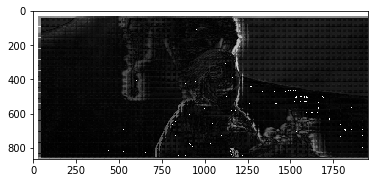

Frame 12


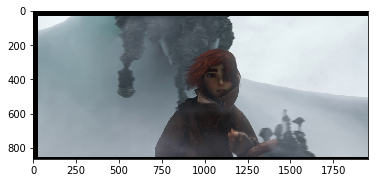

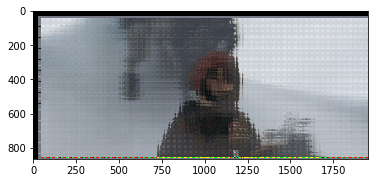

torch.Size([1, 864, 1952])


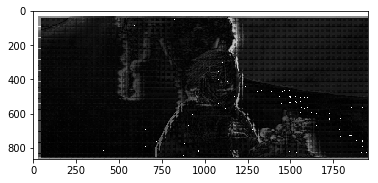

Frame 13


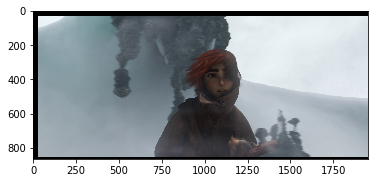

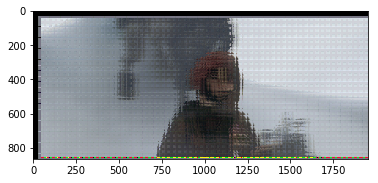

torch.Size([1, 864, 1952])


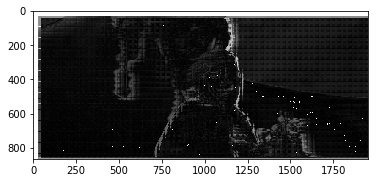

Frame 14


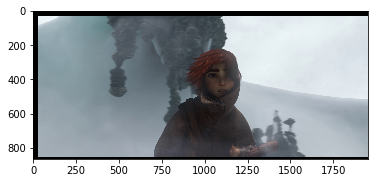

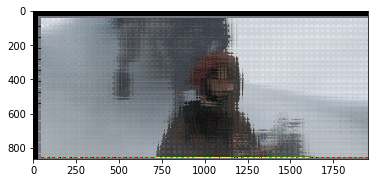

torch.Size([1, 864, 1952])


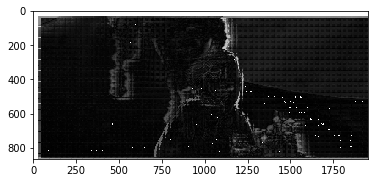

Frame 15


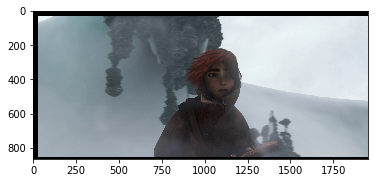

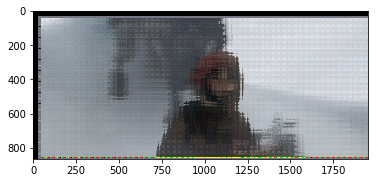

torch.Size([1, 864, 1952])


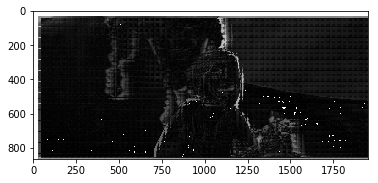

Frame 16


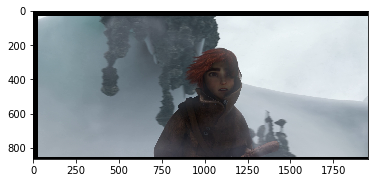

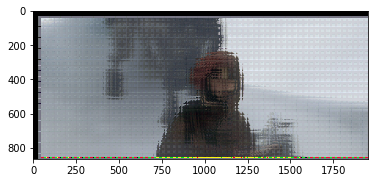

torch.Size([1, 864, 1952])


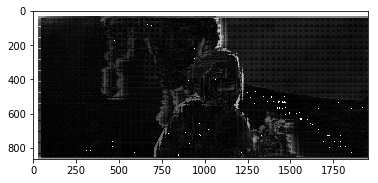

Frame 17


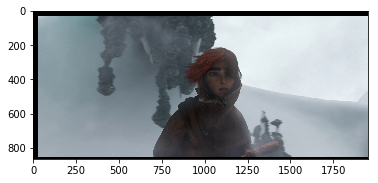

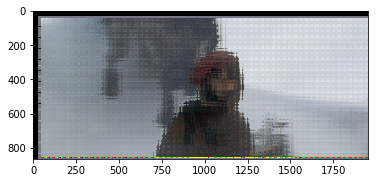

torch.Size([1, 864, 1952])


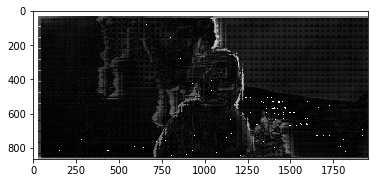

Frame 18


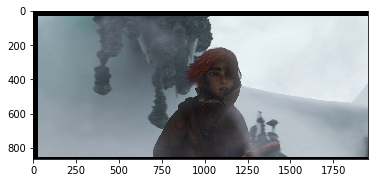

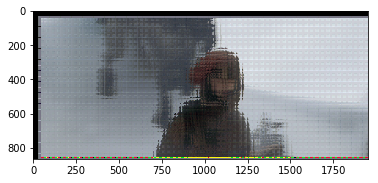

torch.Size([1, 864, 1952])


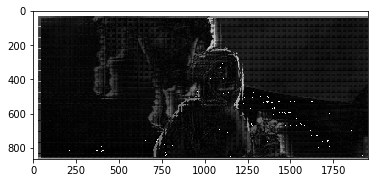

Frame 19


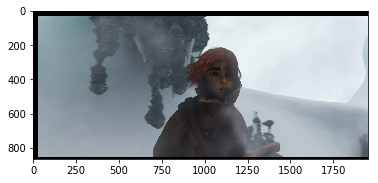

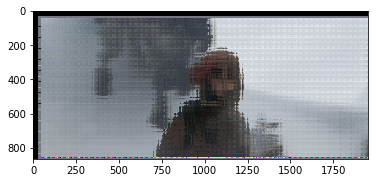

torch.Size([1, 864, 1952])


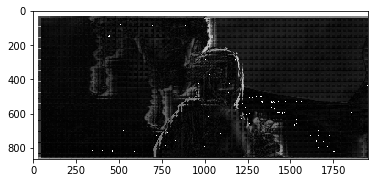

Frame 20


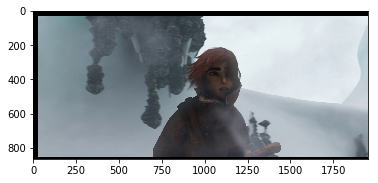

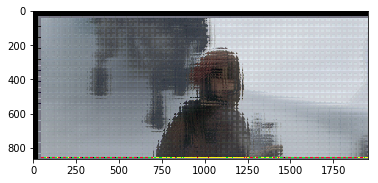

torch.Size([1, 864, 1952])


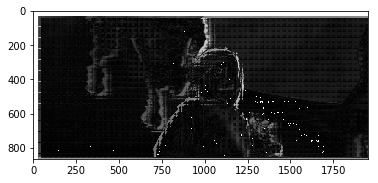

Frame 21


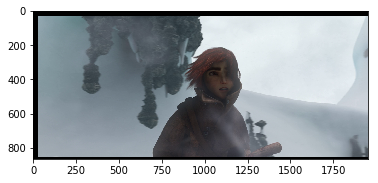

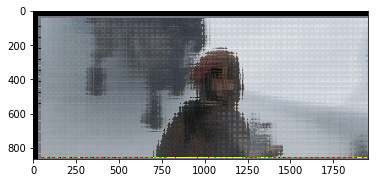

torch.Size([1, 864, 1952])


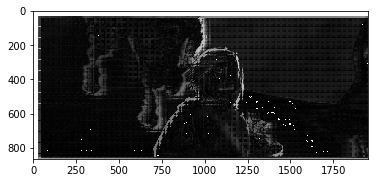

Frame 22


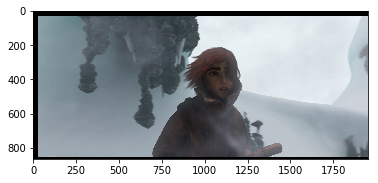

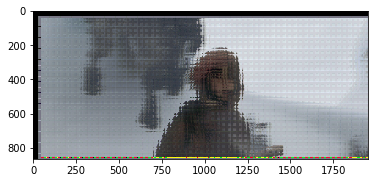

torch.Size([1, 864, 1952])


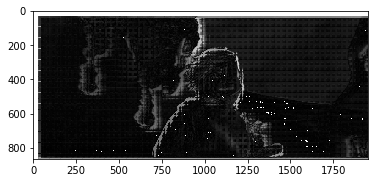

Frame 23


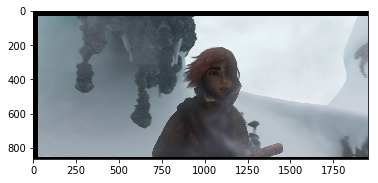

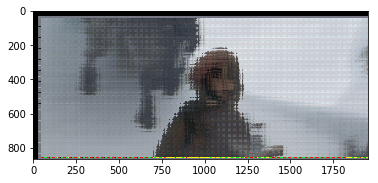

torch.Size([1, 864, 1952])


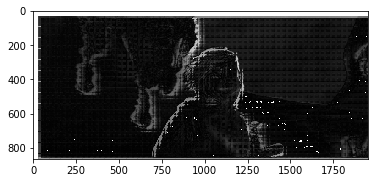

Frame 24


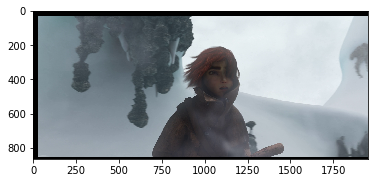

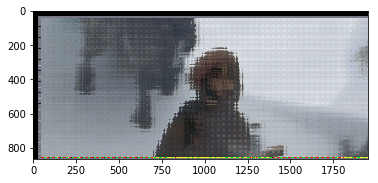

torch.Size([1, 864, 1952])


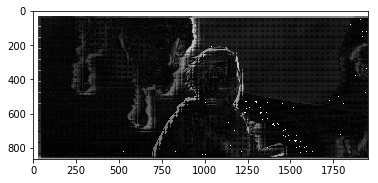

Frame 25


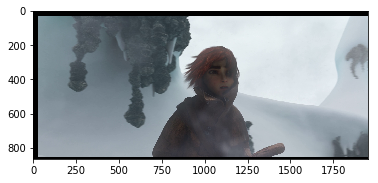

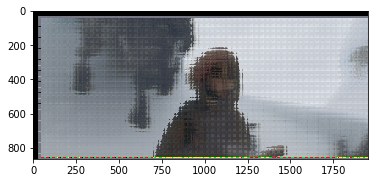

torch.Size([1, 864, 1952])


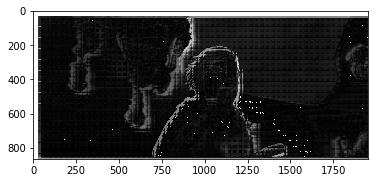

Frame 26


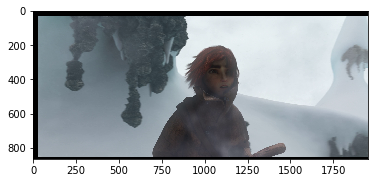

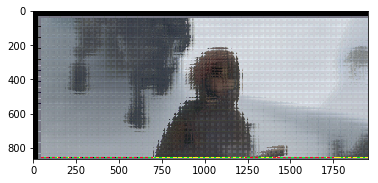

torch.Size([1, 864, 1952])


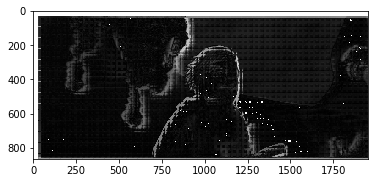

Frame 27


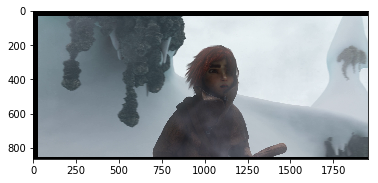

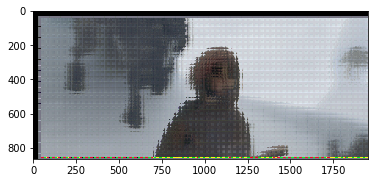

torch.Size([1, 864, 1952])


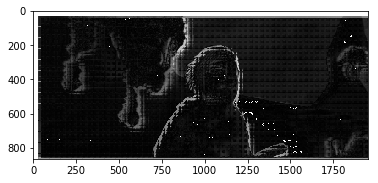

Frame 28


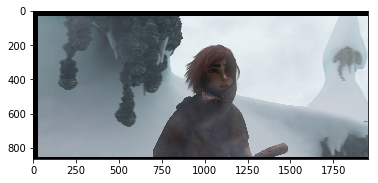

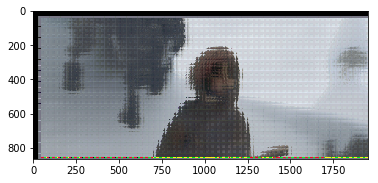

torch.Size([1, 864, 1952])


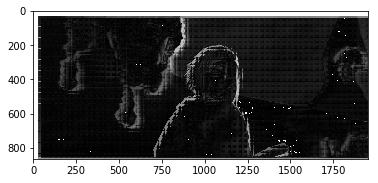

Frame 29


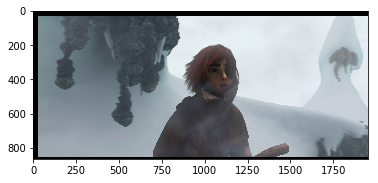

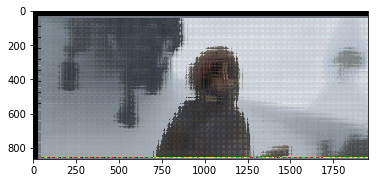

torch.Size([1, 864, 1952])


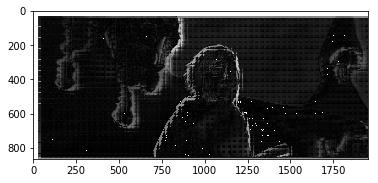

Frame 30


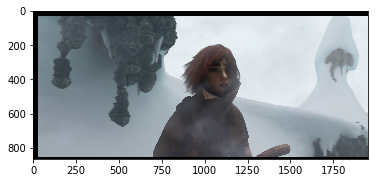

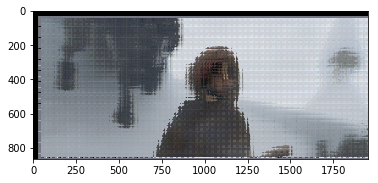

torch.Size([1, 864, 1952])


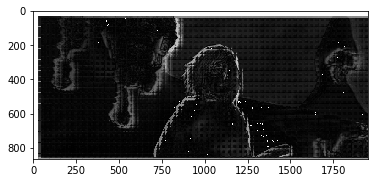

Frame 31


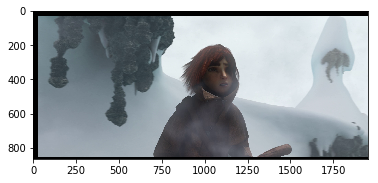

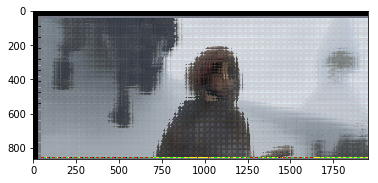

torch.Size([1, 864, 1952])


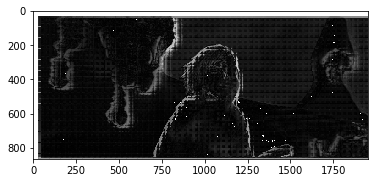

Frame 32


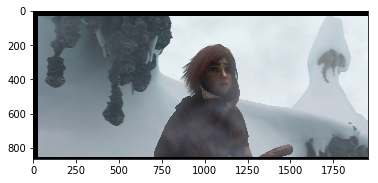

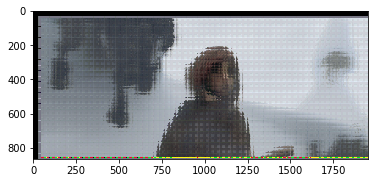

torch.Size([1, 864, 1952])


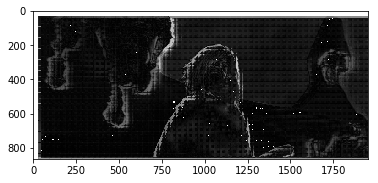

Frame 33


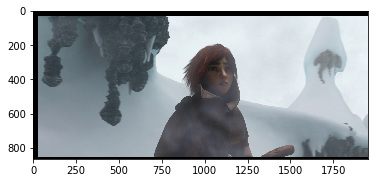

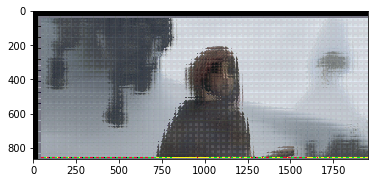

torch.Size([1, 864, 1952])


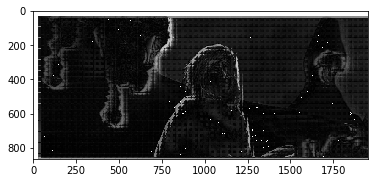

Frame 34


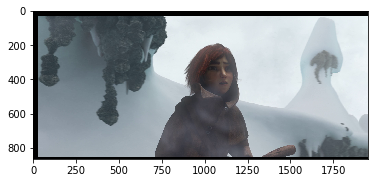

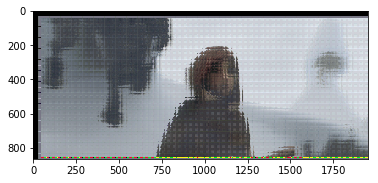

torch.Size([1, 864, 1952])


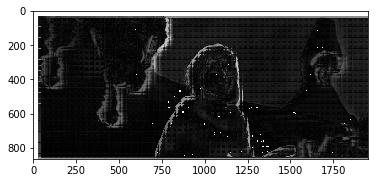

Frame 35


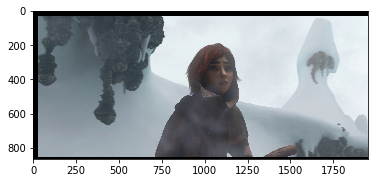

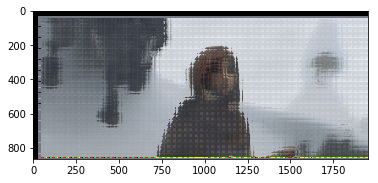

torch.Size([1, 864, 1952])


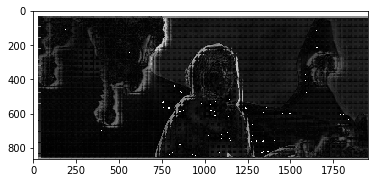

Frame 36


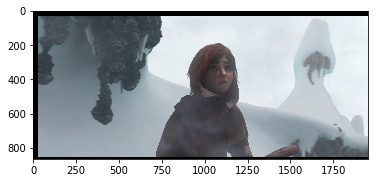

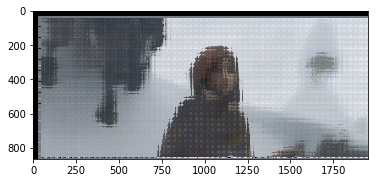

torch.Size([1, 864, 1952])


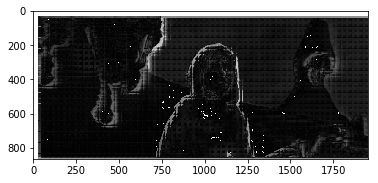

Frame 37


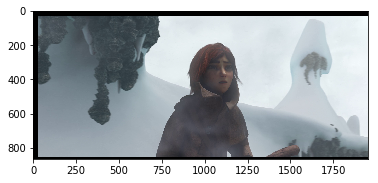

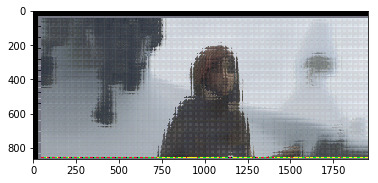

torch.Size([1, 864, 1952])


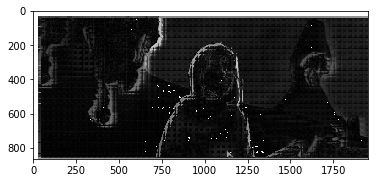

Frame 38


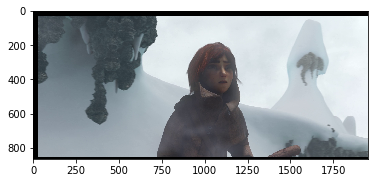

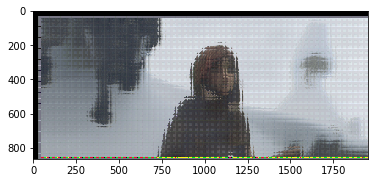

torch.Size([1, 864, 1952])


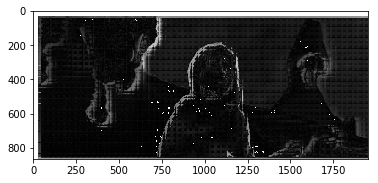

Frame 39


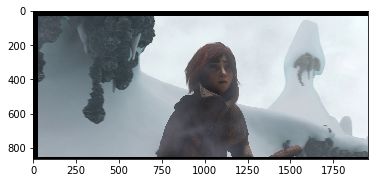

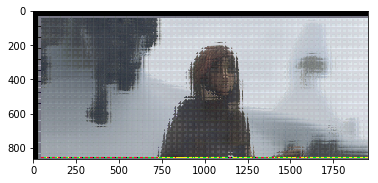

torch.Size([1, 864, 1952])


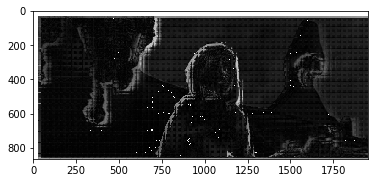

Frame 40


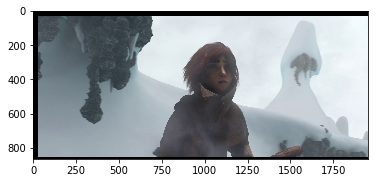

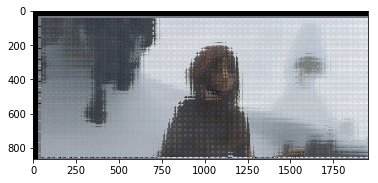

torch.Size([1, 864, 1952])


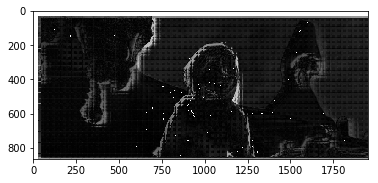

Frame 41


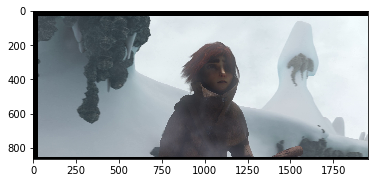

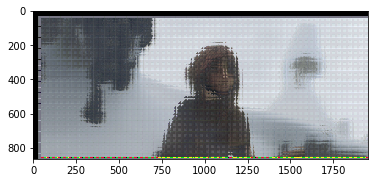

torch.Size([1, 864, 1952])


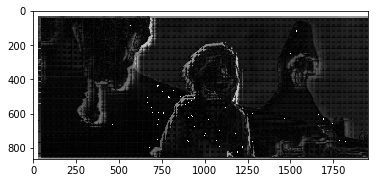

Frame 42


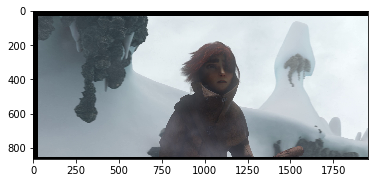

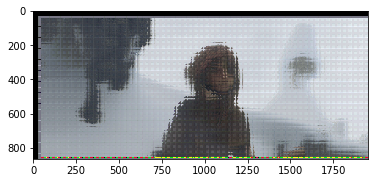

torch.Size([1, 864, 1952])


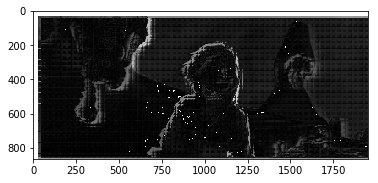

Frame 43


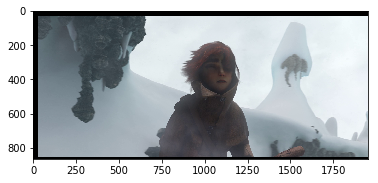

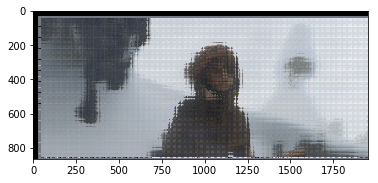

torch.Size([1, 864, 1952])


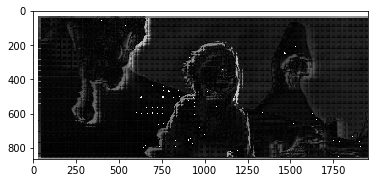

Frame 44


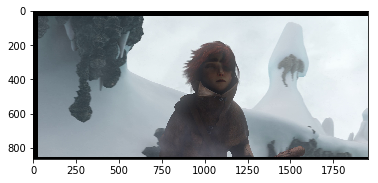

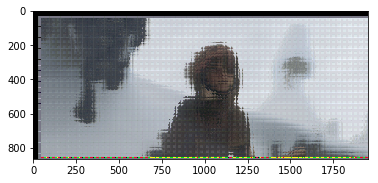

torch.Size([1, 864, 1952])


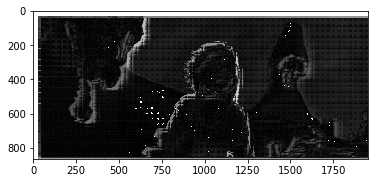

Frame 45


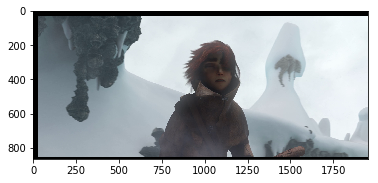

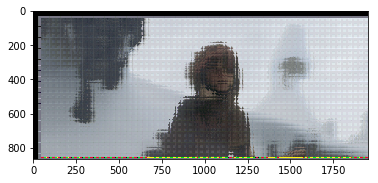

torch.Size([1, 864, 1952])


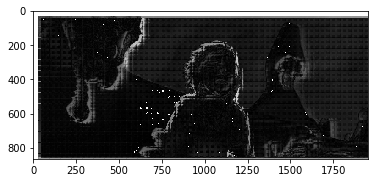

Frame 46


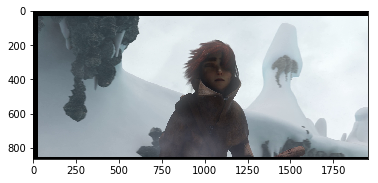

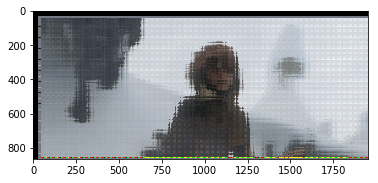

torch.Size([1, 864, 1952])


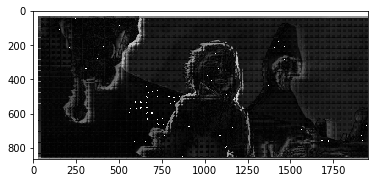

Frame 47


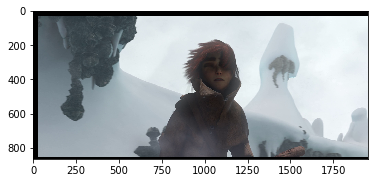

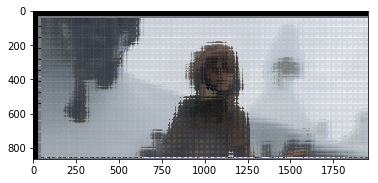

torch.Size([1, 864, 1952])


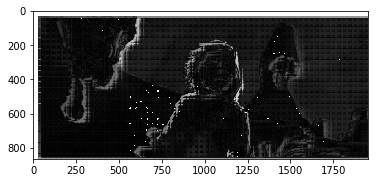

Frame 48


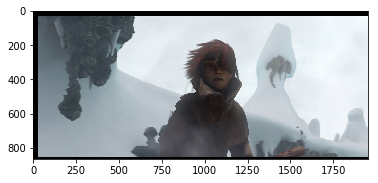

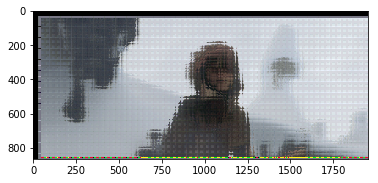

torch.Size([1, 864, 1952])


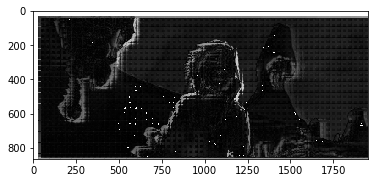

Frame 49


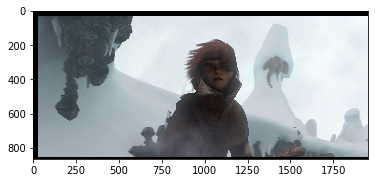

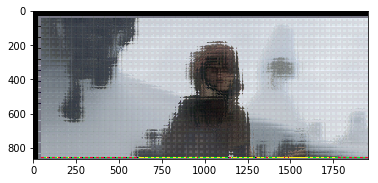

torch.Size([1, 864, 1952])


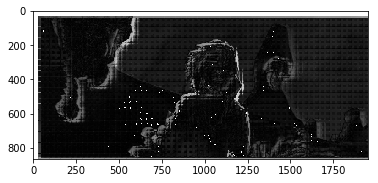

Frame 50


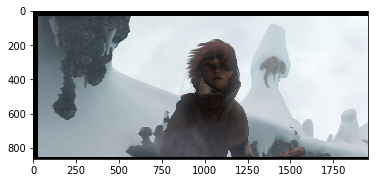

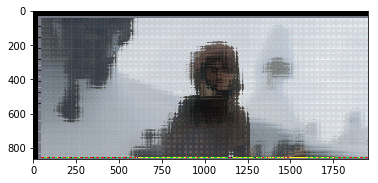

torch.Size([1, 864, 1952])


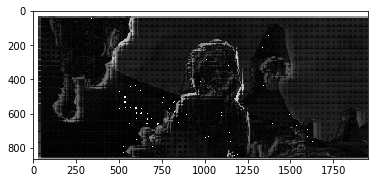

Frame 51


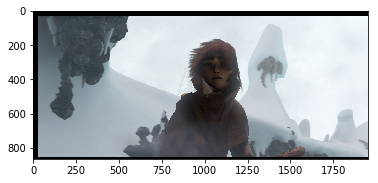

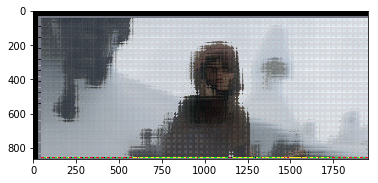

torch.Size([1, 864, 1952])


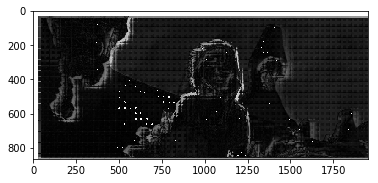

Frame 52


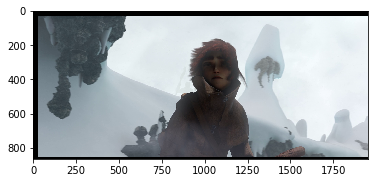

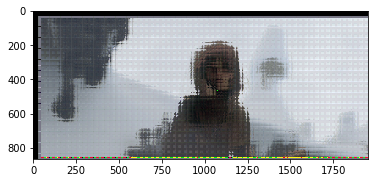

torch.Size([1, 864, 1952])


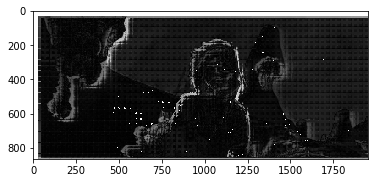

Frame 53


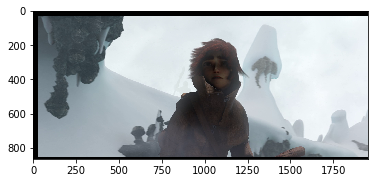

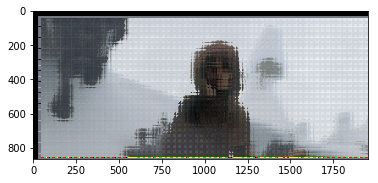

torch.Size([1, 864, 1952])


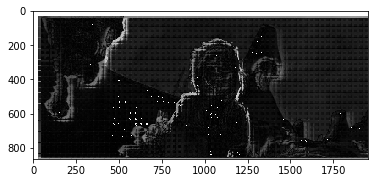

Frame 54


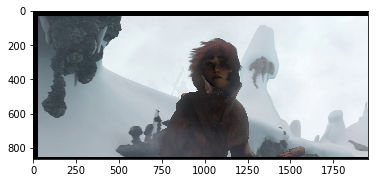

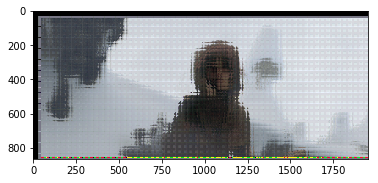

torch.Size([1, 864, 1952])


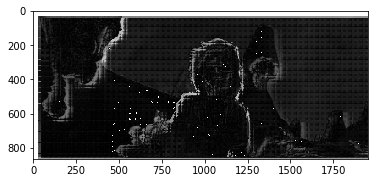

Frame 55


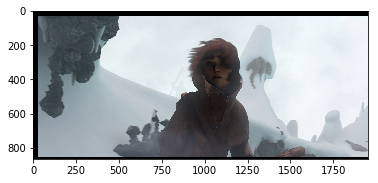

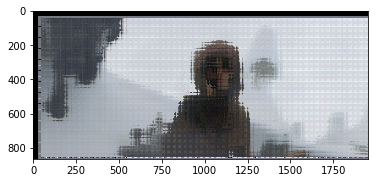

torch.Size([1, 864, 1952])


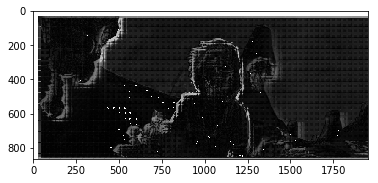

Frame 56


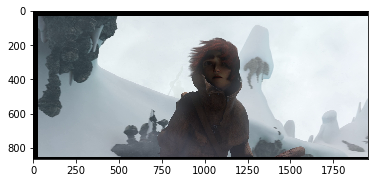

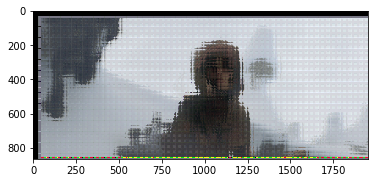

torch.Size([1, 864, 1952])


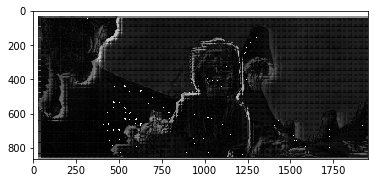

Frame 57


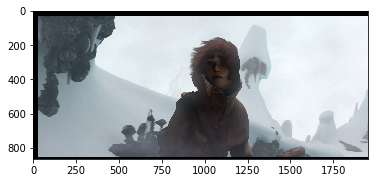

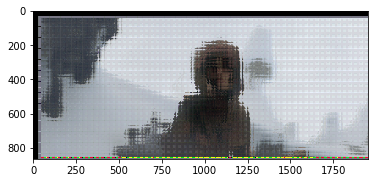

torch.Size([1, 864, 1952])


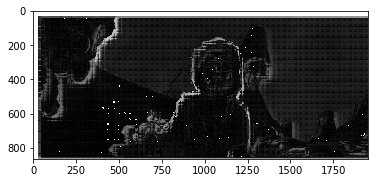

Frame 58


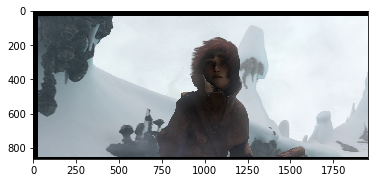

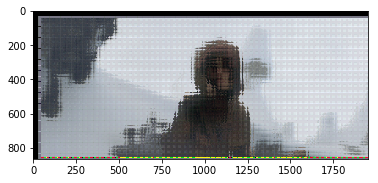

torch.Size([1, 864, 1952])


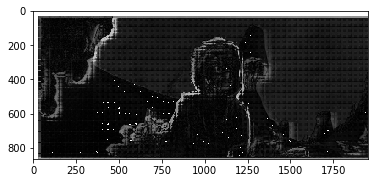

Frame 59


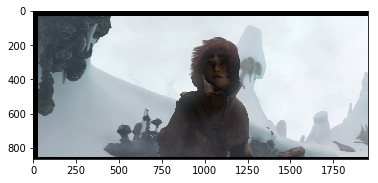

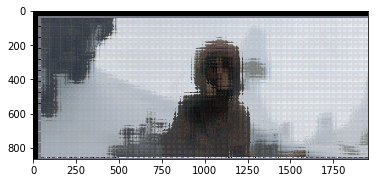

torch.Size([1, 864, 1952])


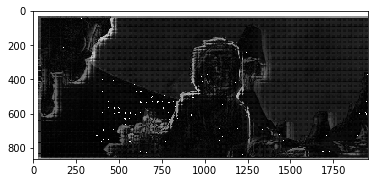

Frame 60


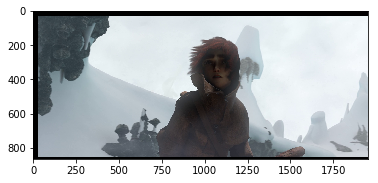

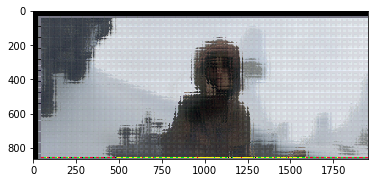

torch.Size([1, 864, 1952])


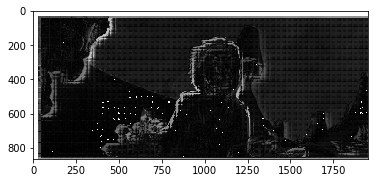

Frame 61


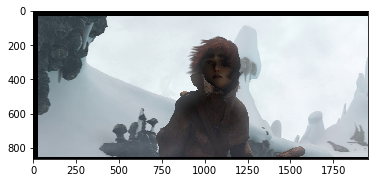

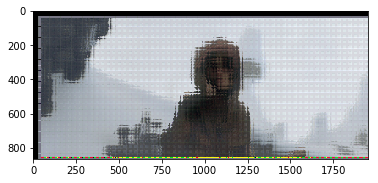

torch.Size([1, 864, 1952])


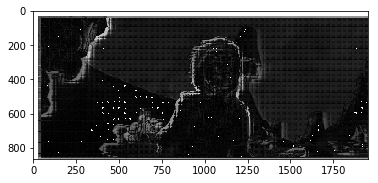

Frame 62


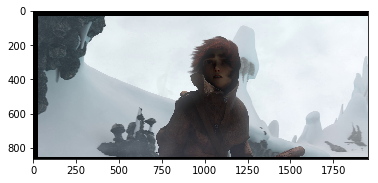

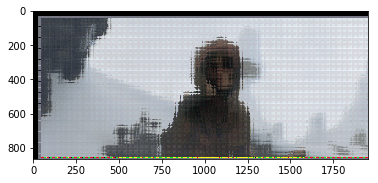

torch.Size([1, 864, 1952])


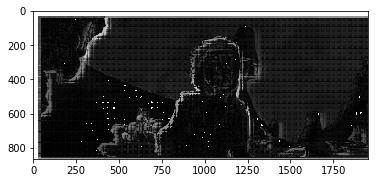

Frame 63


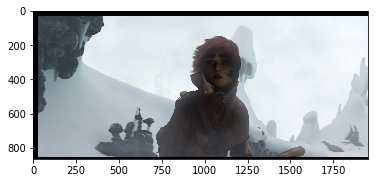

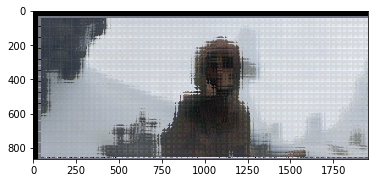

torch.Size([1, 864, 1952])


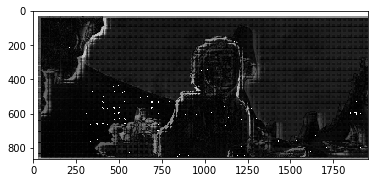

Frame 64


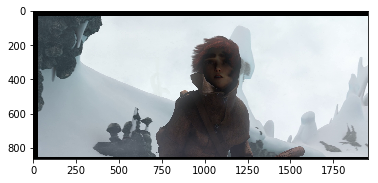

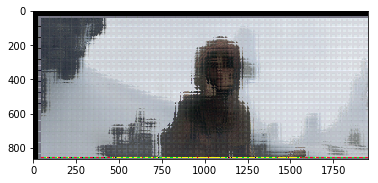

torch.Size([1, 864, 1952])


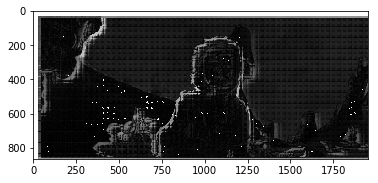

Frame 65


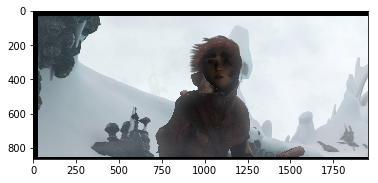

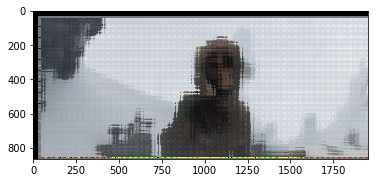

torch.Size([1, 864, 1952])


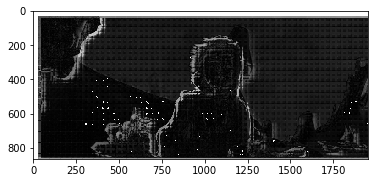

Frame 66


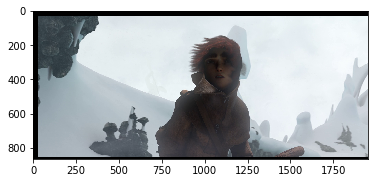

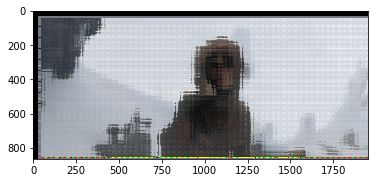

torch.Size([1, 864, 1952])


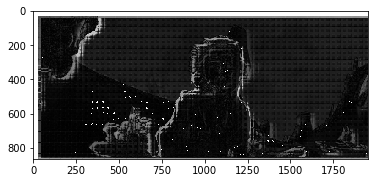

Frame 67


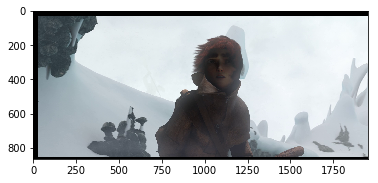

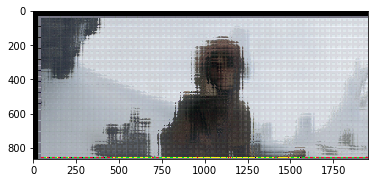

torch.Size([1, 864, 1952])


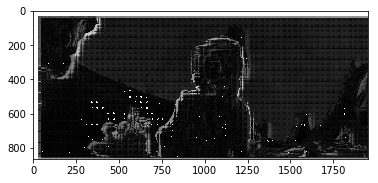

Frame 68


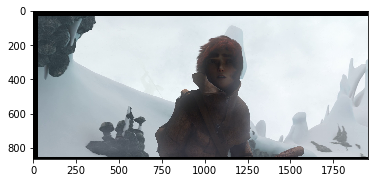

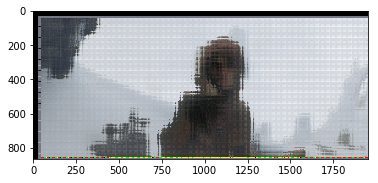

torch.Size([1, 864, 1952])


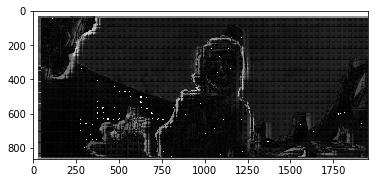

Frame 69


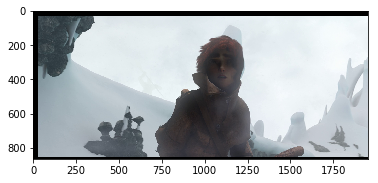

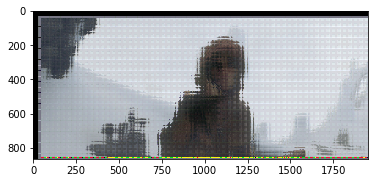

torch.Size([1, 864, 1952])


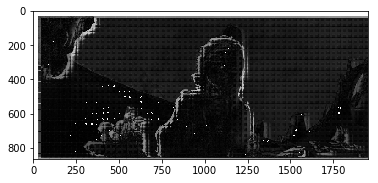

Frame 70


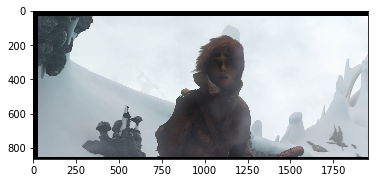

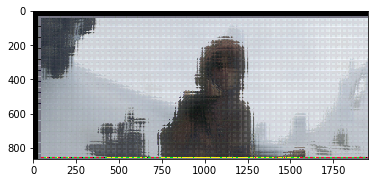

torch.Size([1, 864, 1952])


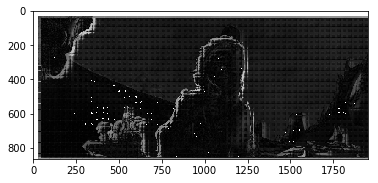

Frame 71


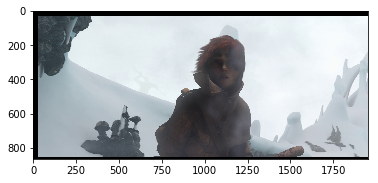

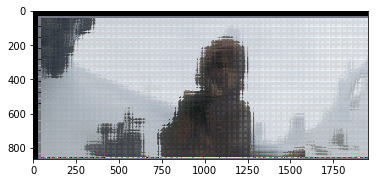

torch.Size([1, 864, 1952])


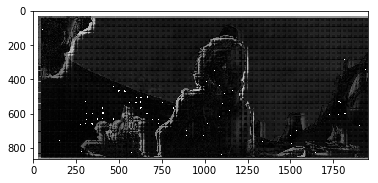

Frame 72


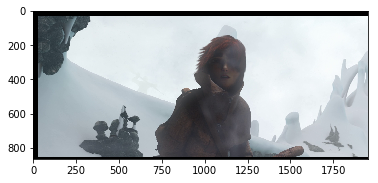

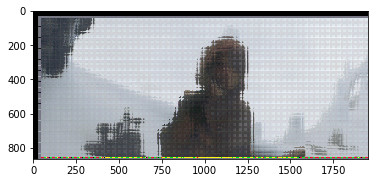

torch.Size([1, 864, 1952])


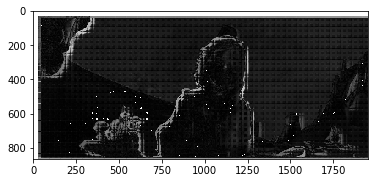

Frame 73


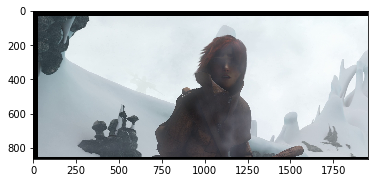

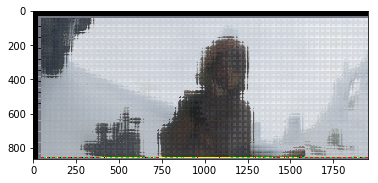

torch.Size([1, 864, 1952])


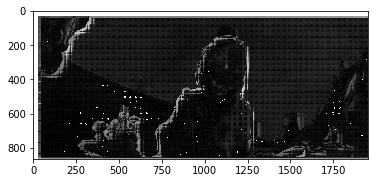

Frame 74


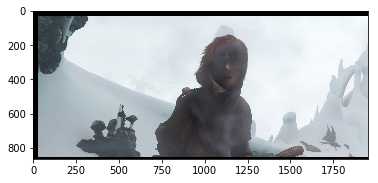

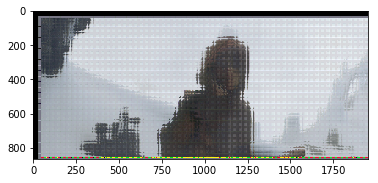

torch.Size([1, 864, 1952])


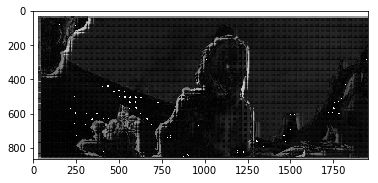

Frame 75


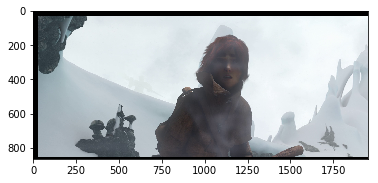

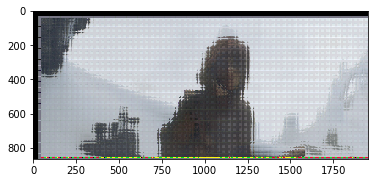

torch.Size([1, 864, 1952])


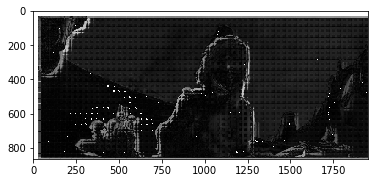

Frame 76


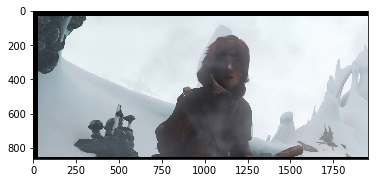

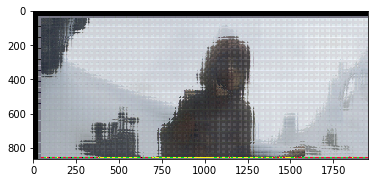

torch.Size([1, 864, 1952])


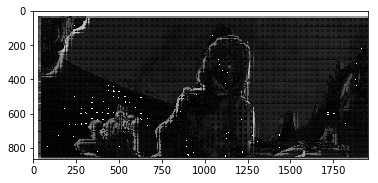

Frame 77


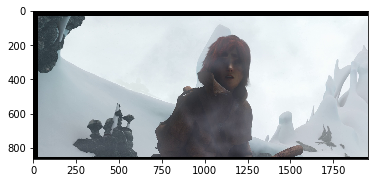

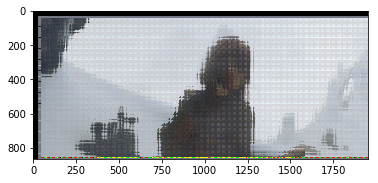

torch.Size([1, 864, 1952])


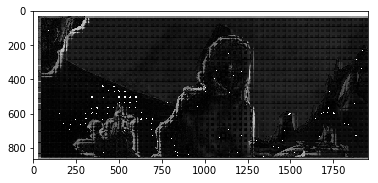

Frame 78


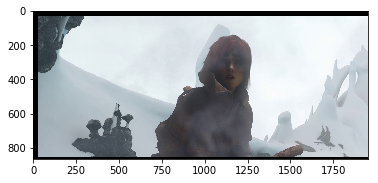

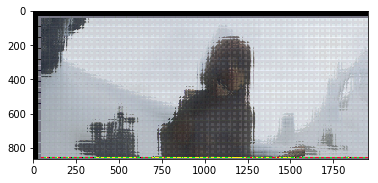

torch.Size([1, 864, 1952])


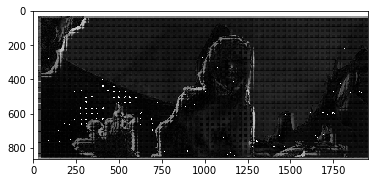

Frame 79


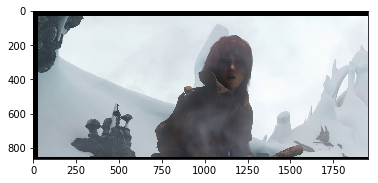

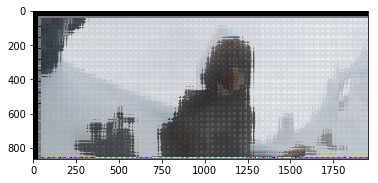

torch.Size([1, 864, 1952])


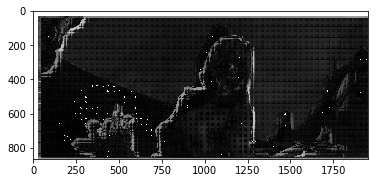

Frame 80


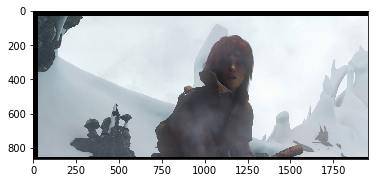

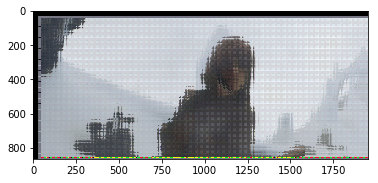

torch.Size([1, 864, 1952])


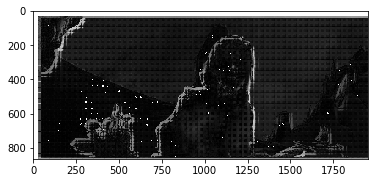

Frame 81


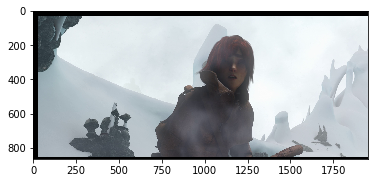

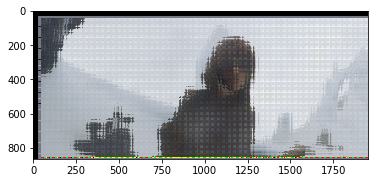

torch.Size([1, 864, 1952])


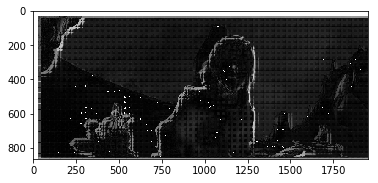

Frame 82


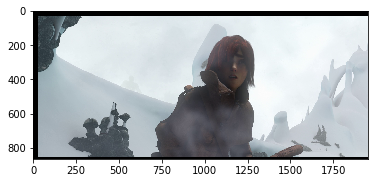

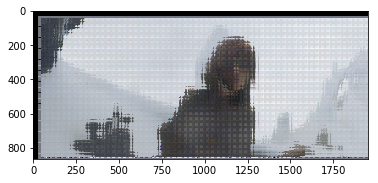

torch.Size([1, 864, 1952])


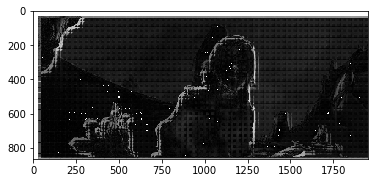

Frame 83


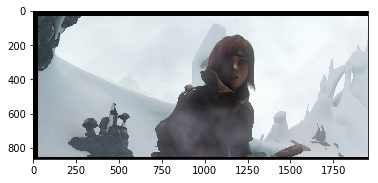

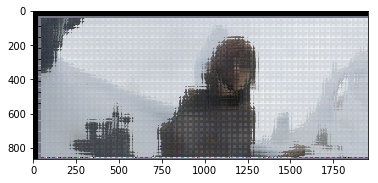

torch.Size([1, 864, 1952])


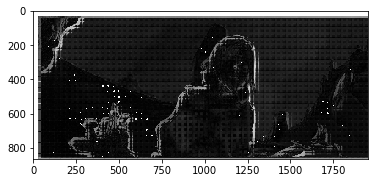

Frame 84


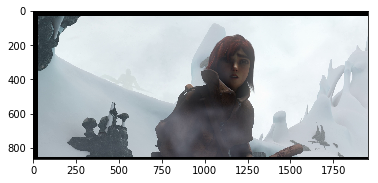

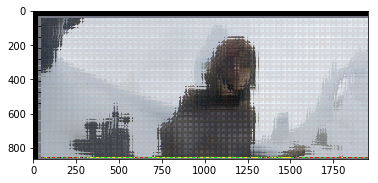

torch.Size([1, 864, 1952])


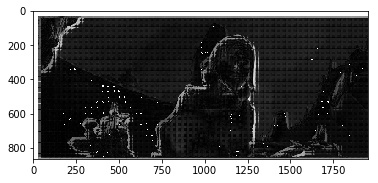

Frame 85


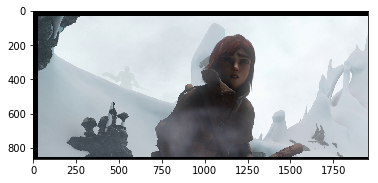

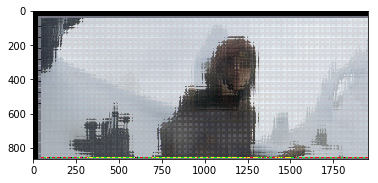

torch.Size([1, 864, 1952])


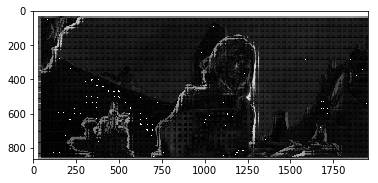

Frame 86


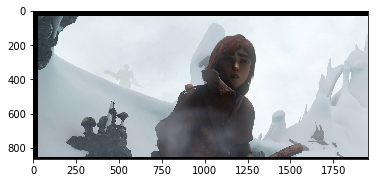

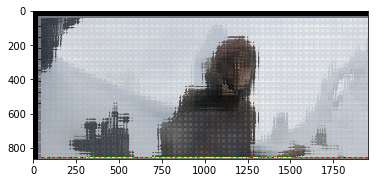

torch.Size([1, 864, 1952])


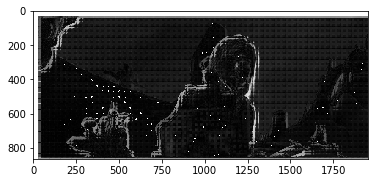

Frame 87


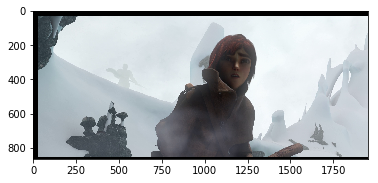

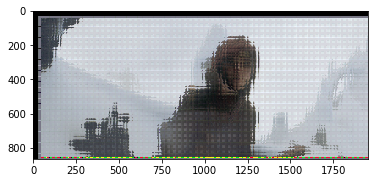

torch.Size([1, 864, 1952])


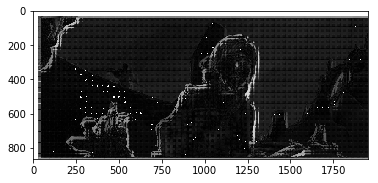

Frame 88


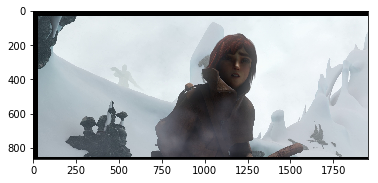

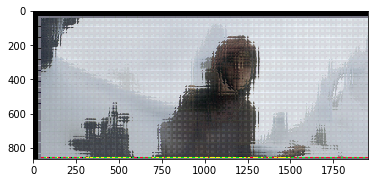

torch.Size([1, 864, 1952])


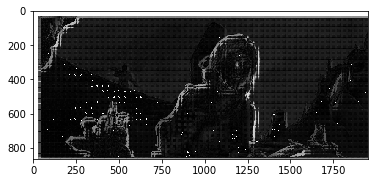

Frame 89


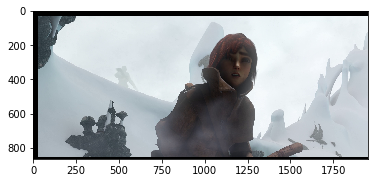

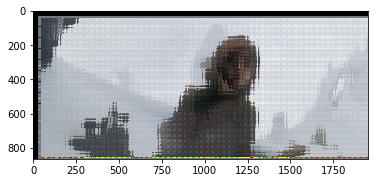

torch.Size([1, 864, 1952])


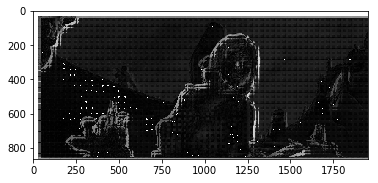

Frame 90


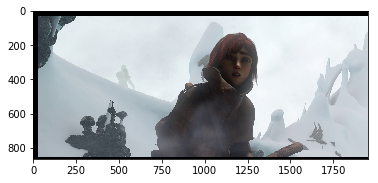

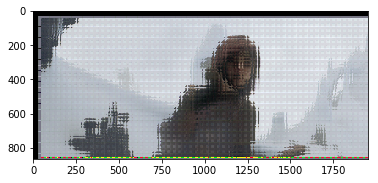

torch.Size([1, 864, 1952])


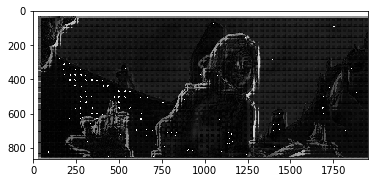

Frame 91


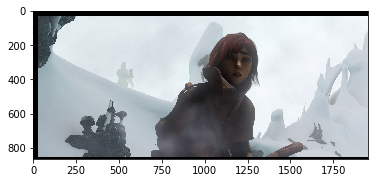

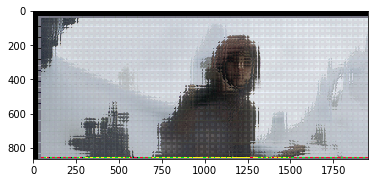

torch.Size([1, 864, 1952])


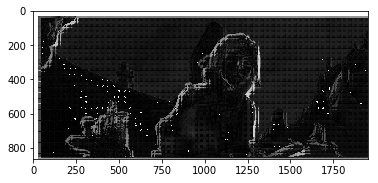

Frame 92


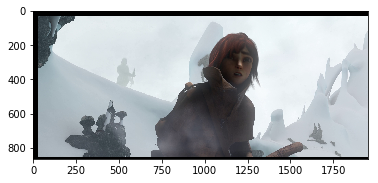

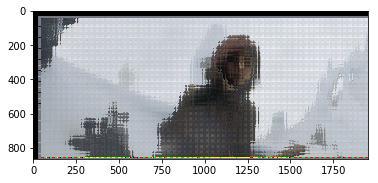

torch.Size([1, 864, 1952])


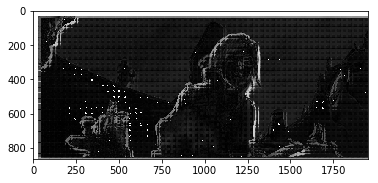

Frame 93


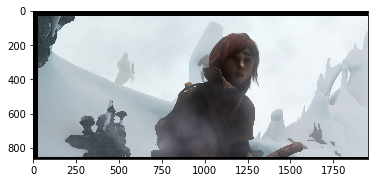

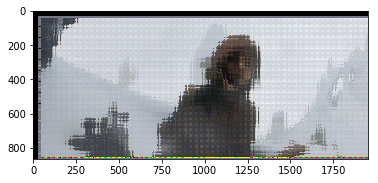

torch.Size([1, 864, 1952])


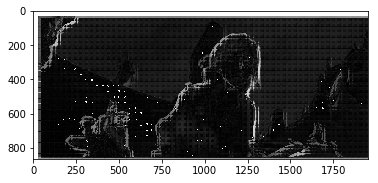

Frame 94


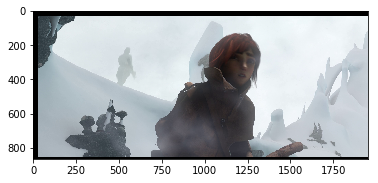

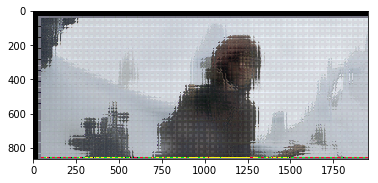

torch.Size([1, 864, 1952])


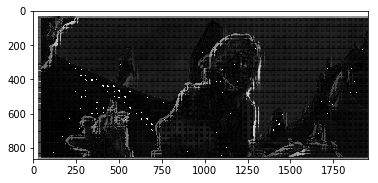

Frame 95


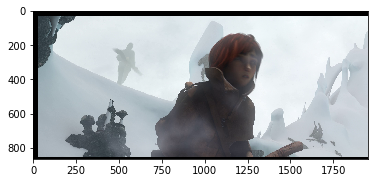

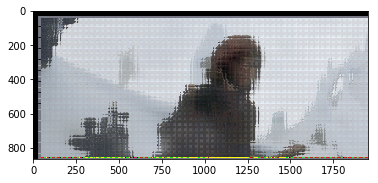

torch.Size([1, 864, 1952])


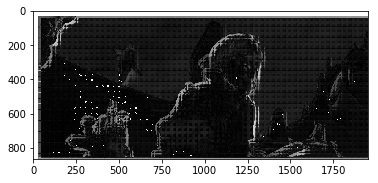

Frame 96


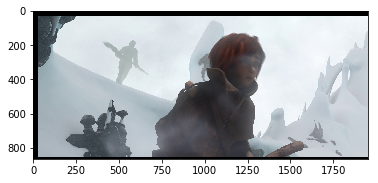

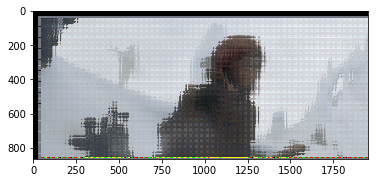

torch.Size([1, 864, 1952])


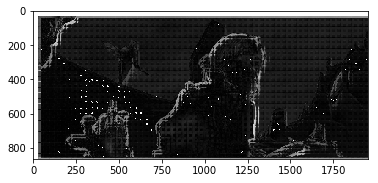

Frame 97


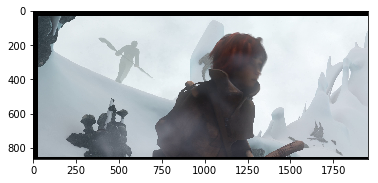

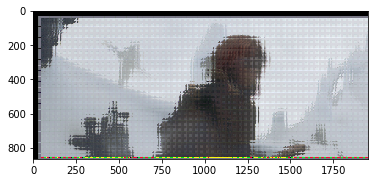

torch.Size([1, 864, 1952])


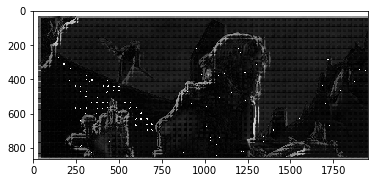

Frame 98


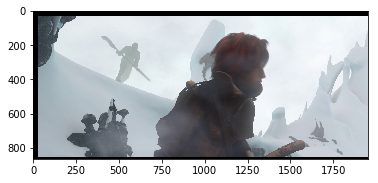

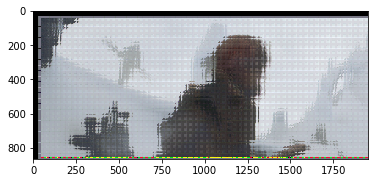

torch.Size([1, 864, 1952])


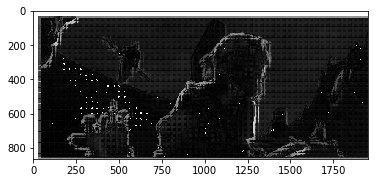

Frame 99


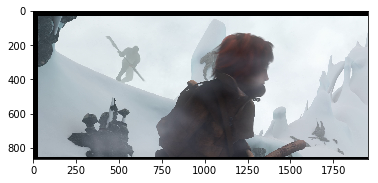

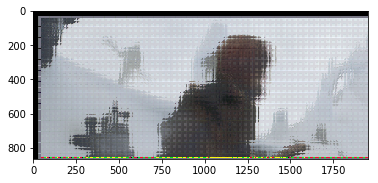

torch.Size([1, 864, 1952])


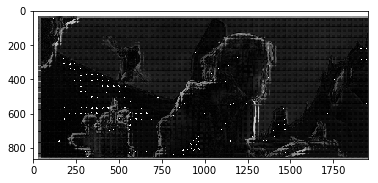

In [13]:
test_loader = load_videos("seqs/full/test.txt", 100)
test_video = next(iter(test_loader))[0]

with torch.no_grad():
    test(model, test_video)